<a href="https://colab.research.google.com/github/WuDianQiBian/WuDianQiBian/blob/main/notebooks/ch02_python_basics/sec06_numpy_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


NumPy简介3 - 进阶操作
==============

# 第九章：数组重组（concat / stack / split 等）

## 9.0 辅助函数（读取/展示图片与视频）

In [ ]:
import imageio
import io
import numpy as np
from IPython.display import display, Image as IPythonImage
from PIL import Image

def read_image(path="/content/drive/MyDrive/Colab Notebooks/Clark.jpg"):
    img = Image.open(path)
    img = np.asarray(img).copy()
    return img

def display_image(img_hwc_uint8):
    if img_hwc_uint8.dtype == np.bool:
        img_hwc_uint8 = img_hwc_uint8.astype(np.uint8) * 255
    img_hwc_uint8 = img_hwc_uint8.astype(np.uint8)
    display(Image.fromarray(img_hwc_uint8))

def display_video_as_gif(video, fps=10, loop=0):
    buf = io.BytesIO()
    imageio.mimsave(buf, video, format="gif", fps=fps, loop=loop)
    display(IPythonImage(data=buf.getvalue(), format="gif"))

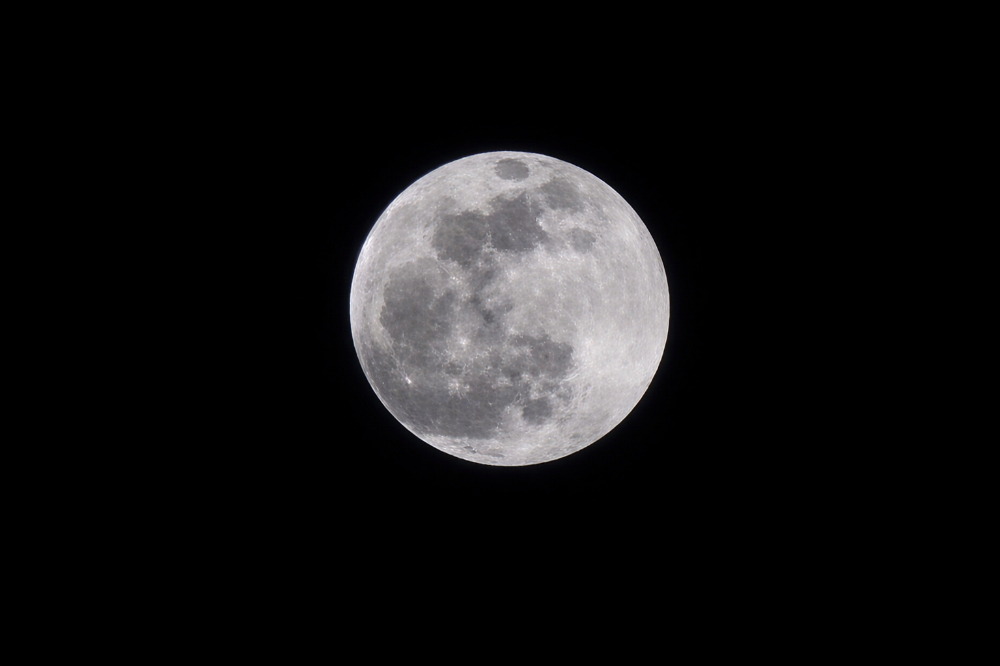

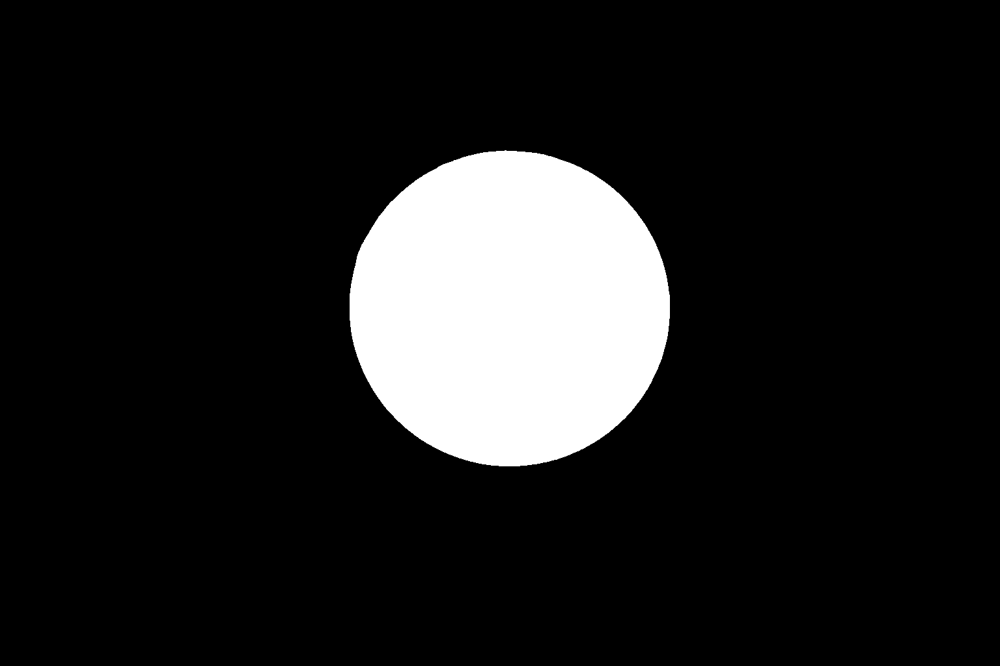

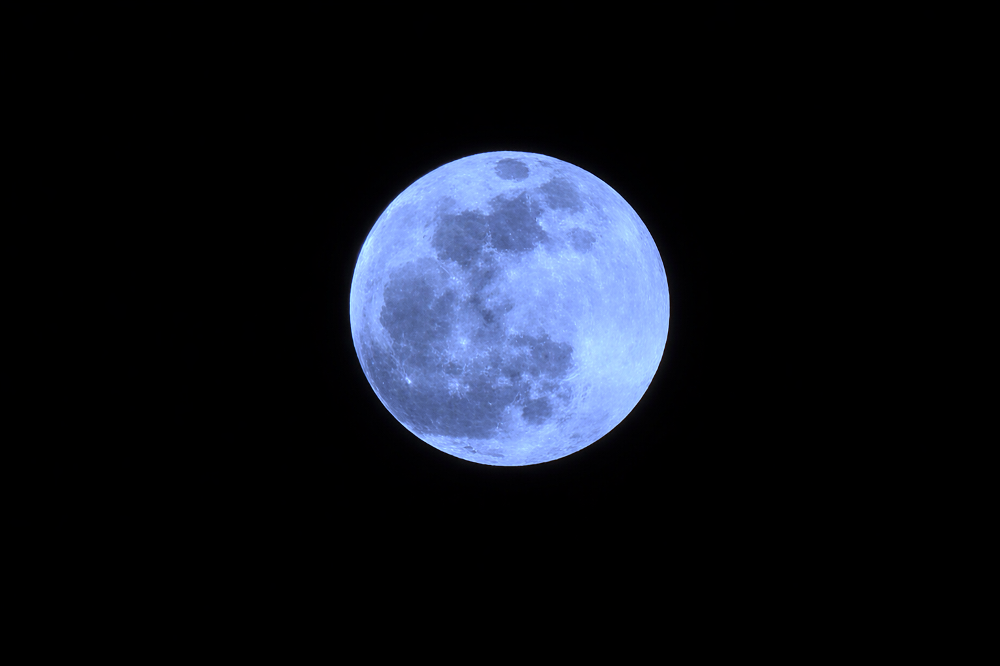

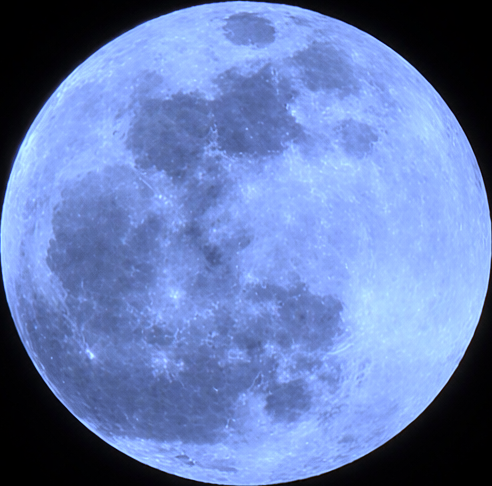

In [ ]:
# read image:
img = read_image("/content/drive/MyDrive/Colab Notebooks/moon.png")
display_image(img)

# generating mask:
mask = np.mean(img, axis=2) > 50
display_image(mask)              # (H, W)

# optimize moon part:
img_f = img.astype(np.float32)   # (H, W, 3)

img_f[mask, 0] *= 0.8            # R
img_f[mask, 1] *= 1.0            # G
img_f[mask, 2] *= 1.5            # B

img = np.clip(img_f, 0, 255).astype(np.uint8)
display_image(img)

# crop moon:
v_mask = np.any(mask, axis=1)
h_mask = np.any(mask, axis=0)

img = img[v_mask][:, h_mask]     # (h_moon, w_moon, 3)
# img = img[np.ix_(v_mask, h_mask)]  # 也可以这样写

display_image(img)

img shape: (600, 800, 3) dtype: uint8


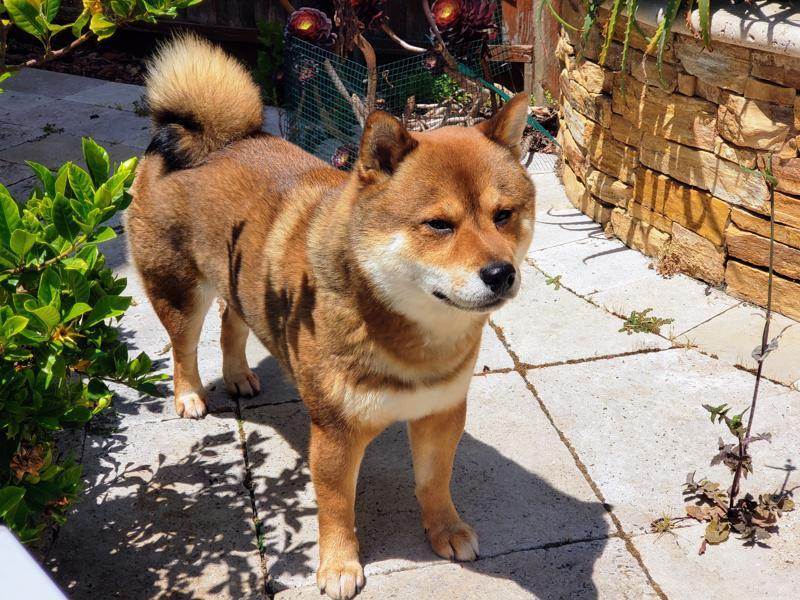

In [ ]:
# 读取图片
img = read_image()
print('img shape:', img.shape, 'dtype:', img.dtype)
display_image(img)

## 9.1 np.concatenate：拼接（不增加维度）

核心直觉：
- `concatenate` 只会让某个 `axis` 方向变长 (拼接)
- 不会新增维度


### 9.1.1 图片横向拼接

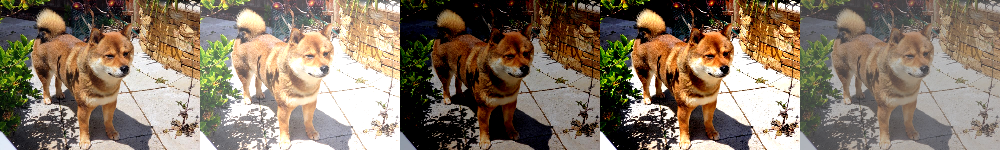

In [ ]:
bright = np.clip(img + 80.0, 0, 255).astype(np.uint8)
dark   = np.clip(img - 80.0, 0, 255).astype(np.uint8)
high_c = np.clip((img - 128.0) * 1.5 + 128, 0, 255).astype(np.uint8)
low_c  = np.clip((img - 128.0) * 0.5 + 128, 0, 255).astype(np.uint8)


hcat = np.concatenate([img, bright, dark, high_c, low_c], axis=1)
display_image(hcat)


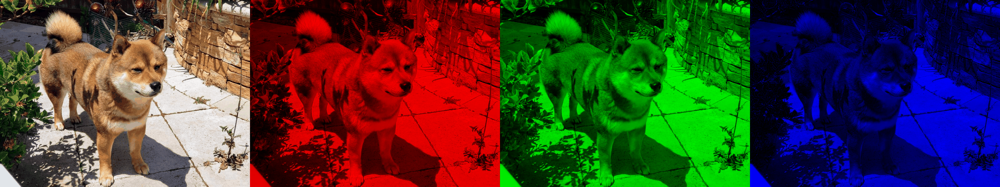

In [ ]:
frames = []

black = np.zeros((img.shape[0], img.shape[1]), dtype=img.dtype)  # (H, W)

for frame in [img, bright, dark, high_c, low_c]:
    # 用 stack 构造 R / G / B 单色图像
    R = np.stack([frame[:, :, 0], black, black], axis=2)  # (H, W) * 3 ⮕ (H, W, 3)
    G = np.stack([black, frame[:, :, 1], black], axis=2)  # (H, W) * 3 ⮕ (H, W, 3)
    B = np.stack([black, black, frame[:, :, 2]], axis=2)  # (H, W) * 3 ⮕ (H, W, 3)

    # 用 concatenate 将它们在水平方向拼接
    frame_hcat = np.concat([frame, R, G, B], axis=1)   # (H, W, 3) * 4 ⮕ (H, 4*W, 3)
    frames.append(frame_hcat)

# 在最外层，用 stack 组织成一个视频
video = np.stack(frames, axis=0)                     # (H, 4*W, 3) * N ⮕ (N, H, 4*W, 3)

display_video_as_gif(video, fps=1)


In [ ]:
img2 = 255 - img  # 取反色

# 黑色间隔条
spacer = np.zeros((img.shape[0], 16, img.shape[2]), dtype=img.dtype)

print('img    shape:', img.shape)
print('spacer shape:', spacer.shape)
print('img2   shape:', img2.shape)

img    shape: (600, 800, 3)
spacer shape: (600, 16, 3)
img2   shape: (600, 800, 3)


hcat shape: (600, 1616, 3)


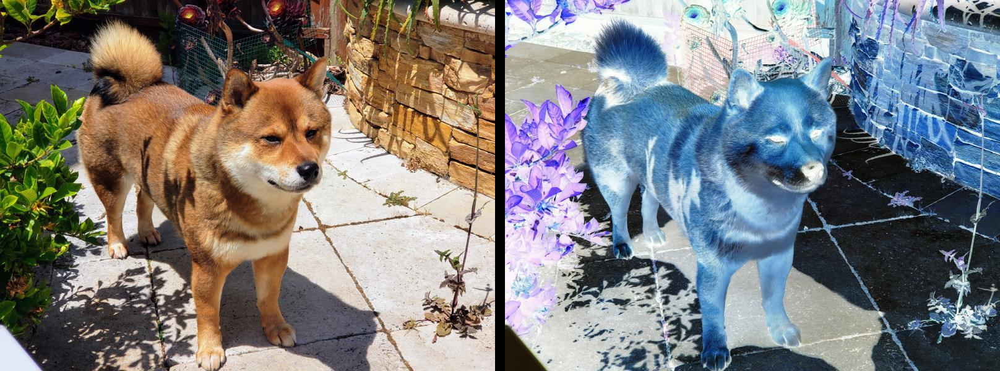

In [ ]:
hcat = np.concatenate([img, spacer, img2], axis=1)
print('hcat shape:', hcat.shape)
display_image(hcat)

### 9.1.2 图片纵向拼接

In [ ]:
img3 = img // 2  # 图片变暗

# 白色间隔条（横条）
spacer_v = np.full((16, img.shape[1], img.shape[2]), 255, dtype=img.dtype)

print('img      shape:', img.shape)
print('spacer_v shape:', spacer_v.shape)
print('img3     shape:', img3.shape)

img      shape: (600, 800, 3)
spacer_v shape: (16, 800, 3)
img3     shape: (600, 800, 3)


vcat shape: (1216, 800, 3)


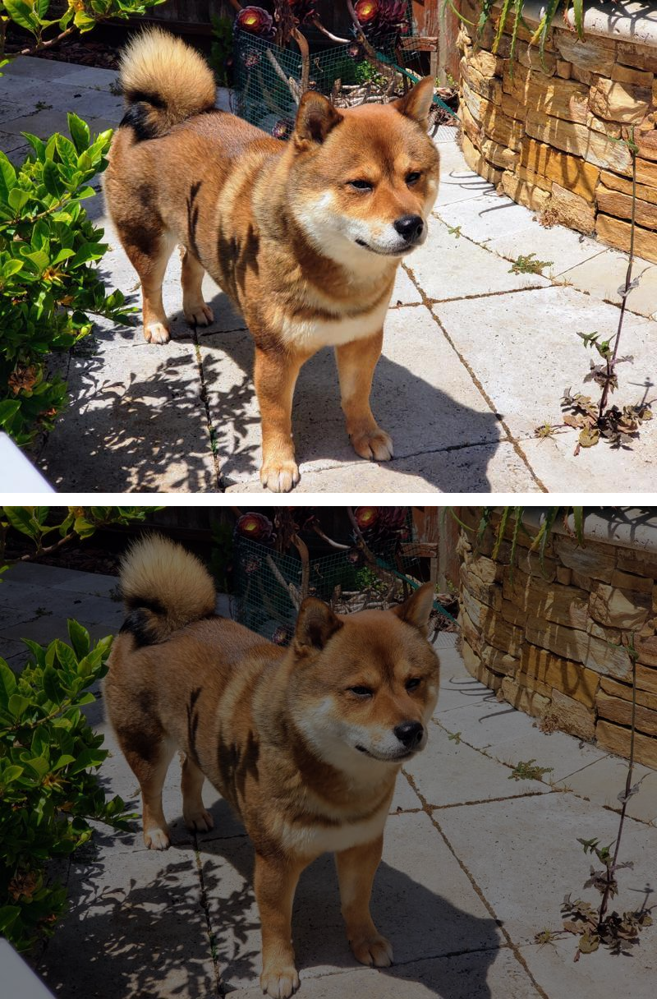

In [ ]:
vcat = np.concatenate([img, spacer_v, img3], axis=0)
print('vcat shape:', vcat.shape)
display_image(vcat)

### 9.1.3 concat 失败示例：除了拼接axis以外，其他维度必须一致

In [ ]:
try:
    bad = np.zeros((512, 800, 3), dtype=img.dtype)  # 与 (600, 800, 3) 在 axis!=1 处不匹配
    np.concatenate([img, bad], axis=1)
except ValueError as e:
    print('ValueError:', e)

ValueError: all the input array dimensions except for the concatenation axis must match exactly, but along dimension 0, the array at index 0 has size 600 and the array at index 1 has size 512


### 9.1.4 concatenate 的一般规则
- 输入数组的 `ndim` 必须相同
- 除了 `axis` 指定维度外，其余维度必须完全一致
- 输出 `ndim` 不变，只有 `shape[axis]` 会变大


## 9.2 np.stack：新增一个维度再拼接

### 9.2.1 HW 灰度图 stack 成 HWC 图片

red shape: (256, 256, 3)


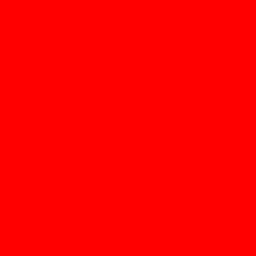

In [ ]:
H, W = 256, 256
light = np.full((H, W), 255, dtype=np.uint8)  # 亮色. Shape: (256, 256)
dark = np.zeros((H, W), dtype=np.uint8)       # 暗色. Shape: (256, 256)

red = np.stack([light, dark, dark], axis=2)   # 红色. Shape: (256, 256, 3)
print('red shape:', red.shape)
display_image(red)

### 9.2.2 多张 HWC 图片 stack 成 NHWC 视频

video shape: (5, 256, 256, 3)


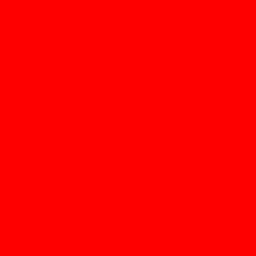

In [ ]:
green = np.stack([dark, light, dark], axis=2)               # (256, 256, 3)
blue  = np.stack([dark, dark, light], axis=2)               # (256, 256, 3)
white = np.stack([light, light, light], axis=2)             # (256, 256, 3)
black = np.zeros((H, W, 3), dtype=np.uint8)                 # (256, 256, 3)

video = np.stack([red, green, blue, white, black], axis=0)  # (5, 256, 256, 3)
print('video shape:', video.shape)
display_video_as_gif(video, fps=1, loop=0)

## 9.3 concatenate + stack 组合
做一个“左右对比”的小视频

video2 shape: (4, 128, 264, 3)


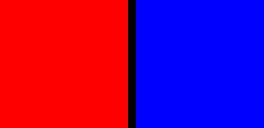

In [ ]:
h, w = 128, 128
light_s = np.full((h, w), 255, dtype=np.uint8)
dark_s  = np.zeros((h, w), dtype=np.uint8)

red   = np.stack([light_s, dark_s,  dark_s], axis=2)         # (128, 128, 3)
blue  = np.stack([dark_s,  dark_s,  light_s], axis=2)        # (128, 128, 3)
green = np.stack([dark_s,  light_s, dark_s], axis=2)         # (128, 128, 3)
black = np.zeros((h, w, 3), dtype=np.uint8)                  # (128, 128, 3)

spacer = np.zeros((h, 8, 3), dtype=np.uint8)                 # (128, 8, 3)

frame1 = np.concatenate([red, spacer, blue], axis=1)         # (128, 264, 3)
frame2 = np.concatenate([black, spacer, green], axis=1)      # (128, 264, 3)
frame3 = np.concatenate([blue, spacer, red], axis=1)         # (128, 264, 3)

video2 = np.stack([frame1, frame2, frame3, frame2], axis=0)  # (4, 128, 264, 3)
print('video2 shape:', video2.shape)
display_video_as_gif(video2, fps=1, loop=0)

## 9.4 split：拆分数组

### 9.4.1 按切点分

p1: (100, 800, 3)


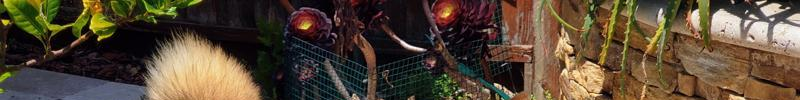

p2: (150, 800, 3)


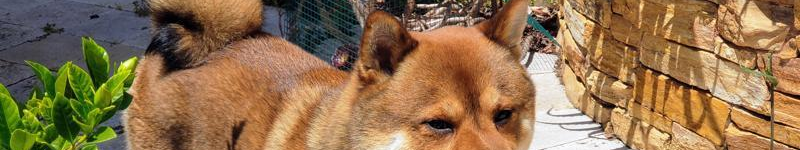

p3: (350, 800, 3)


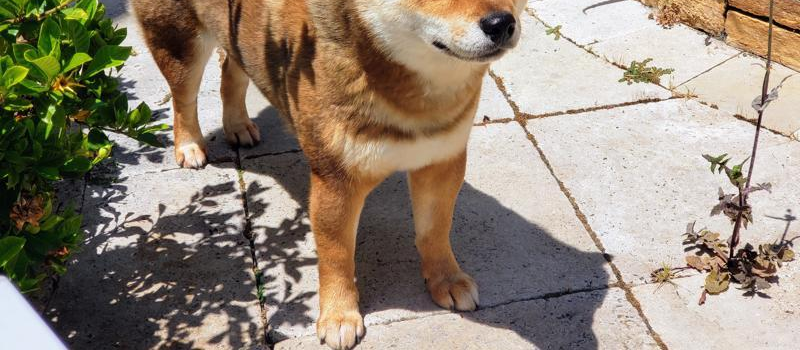

In [ ]:
H, W, C = img.shape
i1 = 100
i2 = 250

p1, p2, p3 = np.split(img, [i1, i2], axis=0)
print('p1:', p1.shape)  # img[:i1,   ...]
display_image(p1)
print('p2:', p2.shape)  # img[i1:i2, ...]
display_image(p2)
print('p3:', p3.shape)  # img[i2:,   ...]
display_image(p3)

### 9.4.2 等分成 N 份

parts[0] shape: (150, 800, 3)


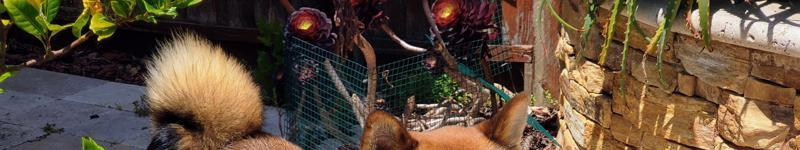

parts[1] shape: (150, 800, 3)


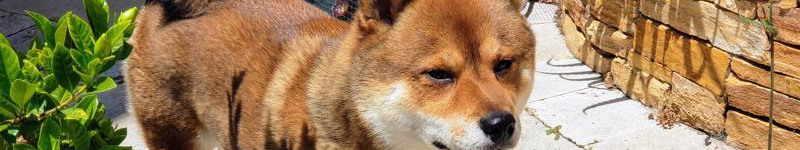

parts[2] shape: (150, 800, 3)


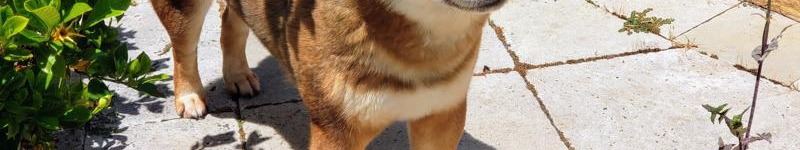

parts[3] shape: (150, 800, 3)


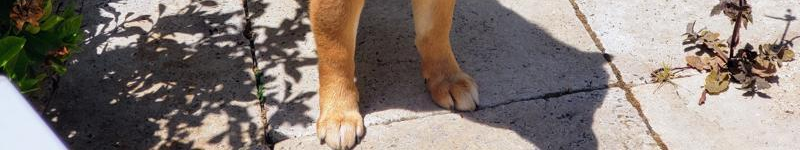

In [ ]:
try:
    parts = np.split(img, 4, axis=0)
    for i, p in enumerate(parts):
        print(f'parts[{i}] shape:', p.shape)
        display_image(p)
except ValueError as e:
    print('ValueError:', e)
    print('提示：np.split(x, 4, axis=0) 要求 x.shape[0] 能被 4 整除。')

## 9.5 其他常用“组合函数”（了解即可）

| 函数                             | 作用（简写说明）                             |
| ------------------------------ | ------------------------------------ |
| **`array_split`**              | 拆分数组（不要求整除）；`split` 的宽容版本            |
| **`hsplit` / `vsplit` / `dsplit`**       | 沿 `axis=1 / 0 / 2` 拆分；`split` 的固定轴写法 |
| **`hstack` / `vstack` / `dstack`**   | 沿列 / 行 / 深度拼接；拼接类函数的快捷写法             |
| **`column_stack` / `row_stack`**   | 将 1D 数组按列 / 行拼成 2D                   |
| **`block`**                    | 按“积木布局”拼数组；可读性高的多次拼接                 |
| **`tile` / `repeat`**                   | 复制并扩展数组；`tile` 复制整体结构，`repeat` 复制元素 |
| **`unstack`**                  | NumPy 无原生接口；通常用 `split` 或索引实现        |


## 9.6 总结

- 拼但不加维度 → `concatenate`
- 拼且要加维度 → `stack`
- 一个变多个 → `split`
- 更多操作 → 查询 API


# 第十章：维度操作（transpose / swapaxes / moveaxis / expand_dims / squeeze）

这一章只关注：**不改变数据内容**，只改变 **维度结构 / 维度顺序**。

## 10.1 转置: `.T`

二维矩阵:

In [ ]:
a = np.arange(6).reshape(2, 3)
print('a.shape  =', a.shape)
print(a)

b = a.T  # 矩阵转置
print('\nb.shape =', b.shape)
print(b)

a.shape  = (2, 3)
[[0 1 2]
 [3 4 5]]

b.shape = (3, 2)
[[0 3]
 [1 4]
 [2 5]]


高维数组:

In [ ]:
x = np.random.rand(2, 3, 4, 5)
y = x.T  # 高维数组：axes 全部反转，因此 y.shape = (5, 4, 3, 2)
print(f"{x.shape=}\n{y.shape=}")

x.shape=(2, 3, 4, 5)
y.shape=(5, 4, 3, 2)


### 10.1.2 `.T` 等价于 `transpose()`

In [ ]:
c1 = a.T
c2 = np.transpose(a)
print(f"{c1=}\n{c2=}")

c1=array([[0, 3],
       [1, 4],
       [2, 5]])
c2=array([[0, 3],
       [1, 4],
       [2, 5]])


### 10.1.3 传入 `axes` 参数，指定重排方式
<details>
<summary>查看解释</summary>

原数组`video_nhwc`:
| 维度（axis） | axis=0        | axis=1       | axis=2      | axis=3        |
| -------- | ------------- | ------------ | ----------- | ------------- |
| **size** | 32             | 1080            | 1920           | 3             |
| **语义** | N (批/时间)             | H (高)            | W (宽)           | C (通道)             |

新数组`video_nchw`:
| 新数组维度           | axis=0     | axis=1 | axis=2 | axis=3 |
| --------------- | ---------- | ------ | ------ | ------ |
| **来自原数组的 axis** | 0          | 3      | 1      | 2      |
| **原始 size**     | 32          | 3      | 1080      | 1920      |
| **转置后语义**       | N (批/时间)           | C (通道)      | H (高)      | W (宽)      |

<br/>


**总结: `np.transpose()`中`axes`规则:**

- `axes[i]` 表示：新数组的第 `i` 个 `axis`，来自原数组的哪个 `axis`。

</details>

In [ ]:
video_nhwc = np.random.rand(32, 1080, 1920, 3)            # (N, H, W, C)
print(f"{video_nhwc.shape=}")

video_nchw = np.transpose(video_nhwc, axes=(0, 3, 1, 2))  # (N, C, H, W)
print(f"{video_nchw.shape=}")

video_nhwc.shape=(32, 1080, 1920, 3)
video_nchw.shape=(32, 3, 1080, 1920)


## 10.2 维度调整：swapaxes / moveaxis

### 10.2.1 swapaxes

img.shape        =(600, 800, 3)
img_swapped.shape=(800, 600, 3)


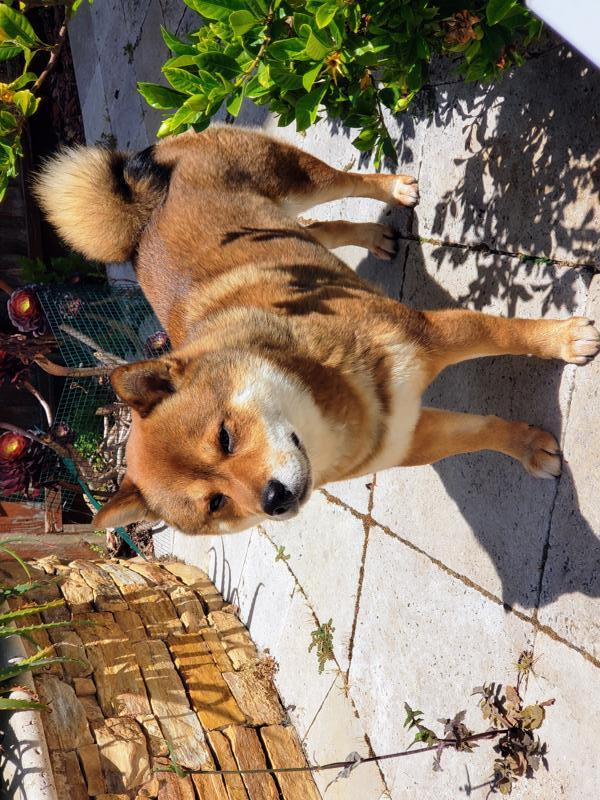

In [ ]:
img_swapped = np.swapaxes(img, 0, 1)
print(f"img.shape        ={img.shape}")
print(f"img_swapped.shape={img_swapped.shape}")
display_image(img_swapped)

### 10.2.2 moveaxis

In [ ]:
video_nhwc = np.random.rand(32, 1080, 1920, 3)  # (N,H,W,C)
video_nchw = np.moveaxis(video_nhwc, 3, 1)      # (N,C,H,W)

print(f"{video_nhwc.shape=}")
print(f"{video_nchw.shape=}")

video_nhwc.shape=(32, 1080, 1920, 3)
video_nchw.shape=(32, 3, 1080, 1920)


## 10.3 expand_dims：增加一个长度为 1 的维度

In [ ]:
x = np.arange(6).reshape(2, 3)
print('x.shape =', x.shape)

y0 = np.expand_dims(x, axis=0)  # 等价于x.reshape(1, 2, 3)
y1 = np.expand_dims(x, axis=1)  # 等价于x.reshape(2, 1, 3)
print('expand_dims axis=0 ->', y0.shape)
print('expand_dims axis=1 ->', y1.shape)

x.shape = (2, 3)
expand_dims axis=0 -> (1, 2, 3)
expand_dims axis=1 -> (2, 1, 3)


In [ ]:
# slicing 方式：None / np.newaxis（和expand_dims效果等价）
y0b = x[None, :, :]
y1b = x[:, np.newaxis, :]

print('x[None,:,:].shape        =', y0b.shape)
print('x[:,np.newaxis,:].shape  =', y1b.shape)

x[None,:,:].shape        = (1, 2, 3)
x[:,np.newaxis,:].shape  = (2, 1, 3)


## 10.4 squeeze：删除长度为 1 的维度

In [ ]:
x = np.zeros((1, 3, 1, 4))
print('x.shape =', x.shape)

y = np.squeeze(x)
print('squeeze ->', y.shape)

x.shape = (1, 3, 1, 4)
squeeze -> (3, 4)


In [ ]:
# 指定 axis 进行 squeeze
z = np.squeeze(x, axis=2)
print('squeeze axis=2 ->', z.shape)

squeeze axis=2 -> (1, 3, 4)


## 10.5 ravel / flatten: 拍扁成1维

In [ ]:
x = np.random.rand(3, 4)
y = x.ravel()    # 尽量返回view, 等价于np.reshape(x, -1)
z = x.flatten()  # 返回copy
print(f"{x.shape=}\n{y.shape=}\n{z.shape=}")

x.shape=(3, 4)
y.shape=(12,)
z.shape=(12,)


In [ ]:
print(f"{np.shares_memory(x, y)=}")
print(f"{np.shares_memory(x, z)=}")

np.shares_memory(x, y)=True
np.shares_memory(x, z)=False


## 10.6 小结

- `transpose / .T`：重排维度顺序 / 转置
- `swapaxes`：交换两个维度
- `moveaxis`：移动某个维度到新位置（例如 NHWC ↔ NCHW）
- `expand_dims / newaxis / None`：增加长度为 1 的维度
- `squeeze`：删除长度为 1 的维度
- `ravel / flatten`: 拍扁成1维


# 第十一章：高级索引（Advanced Indexing）
试图解决:
- 想按某种条件选数据
- 想不规则地选一些行或列
- 想在高维数组中“精确点选”部分内容
- view 还是 copy

## 11.1 基础索引回顾（快速）

In [ ]:
x = np.arange(24).reshape(4, 6)
print('x.shape =', x.shape)

x.shape = (4, 6)


In [ ]:
print(f"{x[1, 2]=}")
print(f"{x[1].shape=}")
print(f"{x[:, 2:5].shape=}")

x[1, 2]=np.int64(8)
x[1].shape=(6,)
x[:, 2:5].shape=(4, 3)


## 11.2 布尔索引（Boolean Indexing）

### 11.2.1 mask 与原数组同形状：按条件选像素

img.shape=(600, 800, 3)


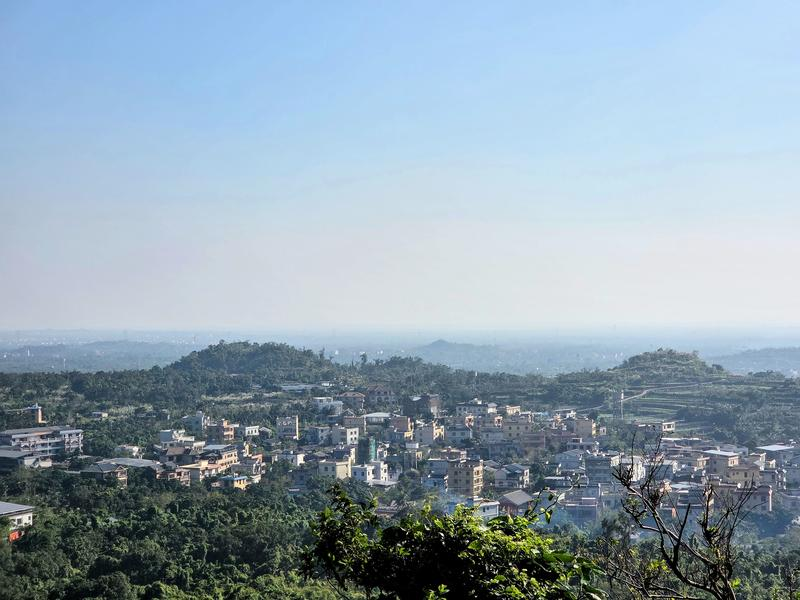

In [ ]:
# 读取图片
img = read_image("/content/drive/MyDrive/Colab Notebooks/Haikou.jpg")
print(f"{img.shape=}")
display_image(img)

img_gray.shape=(600, 800)


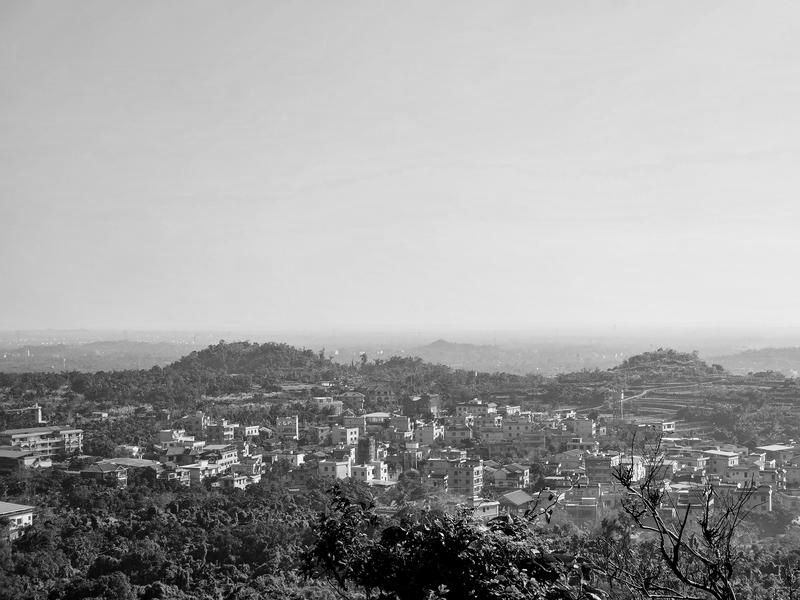

In [ ]:
# 转成黑白图
img_gray = img.mean(axis=2)            # 彩色图片变黑白图: (H,W)
print(f"{img_gray.shape=}")
display_image(img_gray)

mask_dark_area.shape=(600, 800)


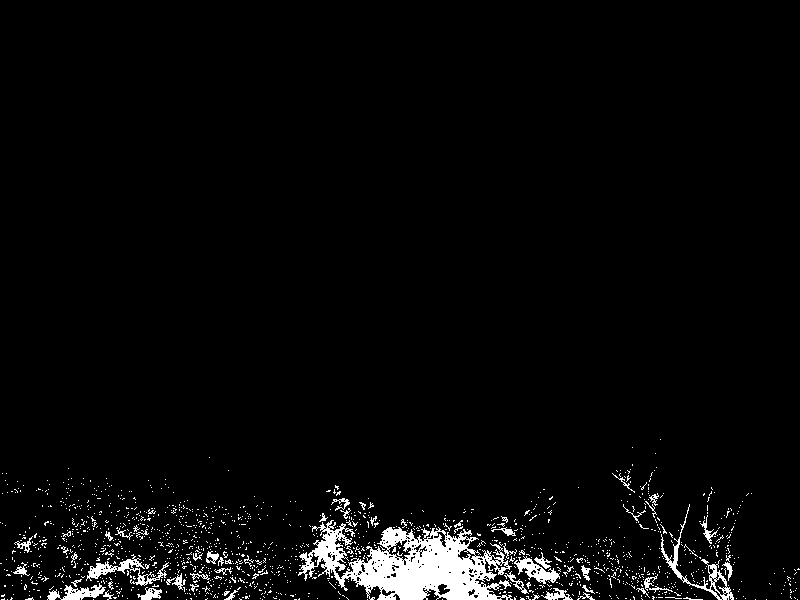

In [ ]:
# 将暗区表示为mask
mask_dark_area = img_gray < 20         # 暗区mask
print(f"{mask_dark_area.shape=}")      # (H, W)
display_image(mask_dark_area)

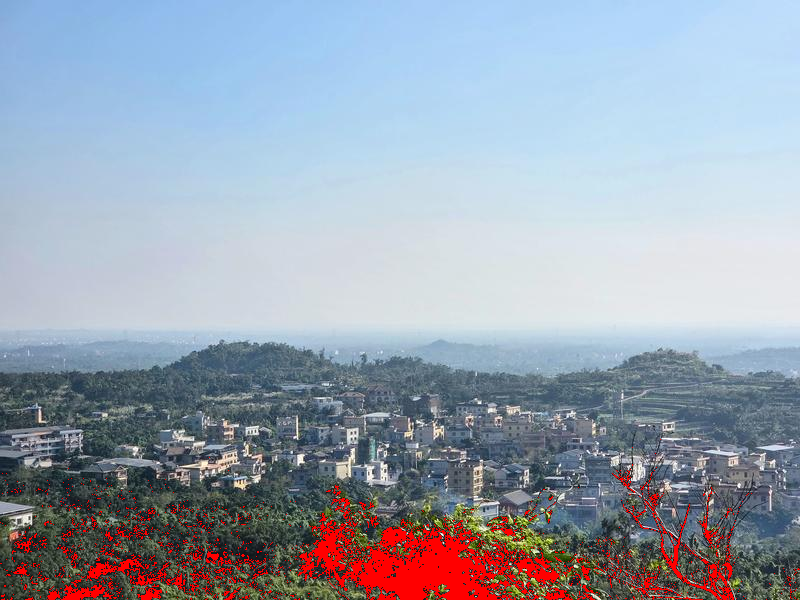

In [ ]:
# 在原图上，将暗区覆盖为红色
overlay = img.copy()
overlay[mask_dark_area] = (255, 0, 0)  # 暗区覆盖为红色
display_image(overlay)

备注：`img[mask]` 本身会返回 shape 为 (num_selected_pixels, 3) 的数组

### 11.2.2 1D mask 选择指定行/列：去掉天空部分

row_mask.shape=(600,)
rows_picked.shape=(261, 800, 3)


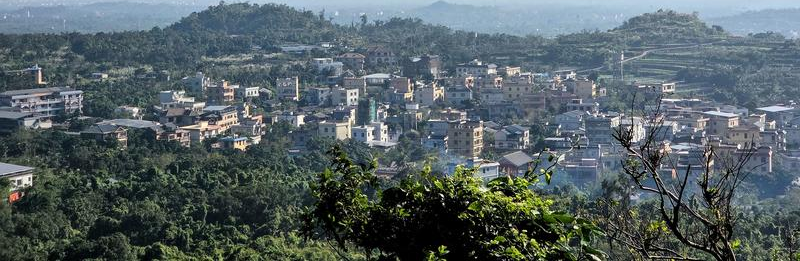

In [ ]:
row_mask = np.mean(img_gray, axis=1) < 200  # 没有那么亮的行是非天空部分
print(f"{row_mask.shape=}")                 # row_mask是1维数组: (H,)

rows_picked = img[row_mask]                 # 只选出这些行（裁掉天空部分）
print(f"{rows_picked.shape=}")              # (num_selected_rows, W, C)
display_image(rows_picked)

## 11.3 花式索引（Fancy / Integer Array Indexing）

花式索引指的是：使用整数数组作为索引。

In [ ]:
# 随机选择100行
selected_rows = np.sort(np.random.randint(0, img.shape[0], 100))  # 先随机，后排序
print(f"{selected_rows.shape=}")  # (100,)

selected_rows.shape=(100,)


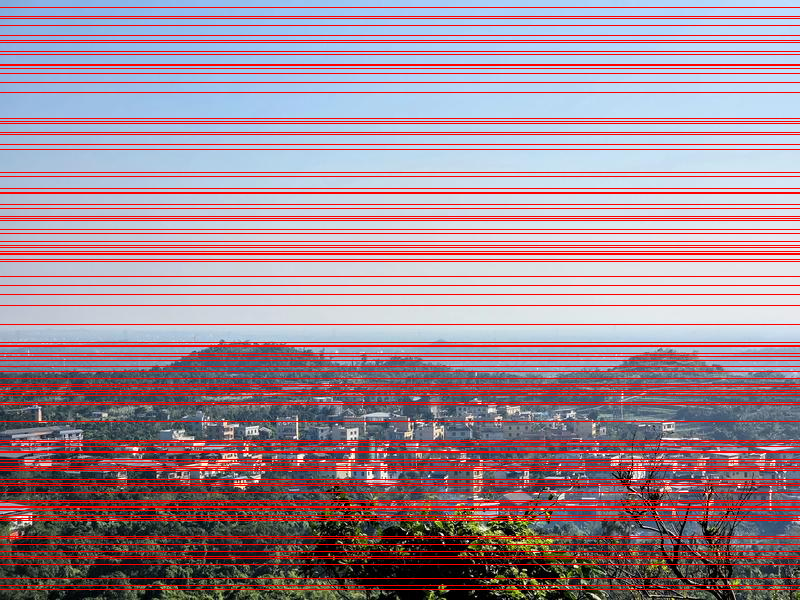

In [ ]:
# 在原始图像上查看这100行
overlay = img.copy()
overlay[selected_rows] = (255, 0, 0)     # 花式索引
display_image(overlay)

selected_img.shape=(100, 800, 3)


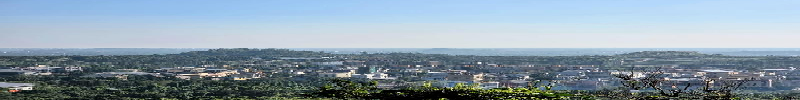

In [ ]:
# 选取这100行:
selected_img = img[selected_rows]  # 花式索引
print(f"{selected_img.shape=}")     # (100, W, C)
display_image(selected_img)        # 拿到选取的行

## 11.4 用 `np.ix_` 做“行列网格采样”

当你同时有 rows 和 cols 时：
- `img[rows, cols]` 的语义是“逐元素配对取点”（常得到一堆像素点）
- `img[np.ix_(rows, cols)]` 的语义是“行列网格”（得到一张新图片）

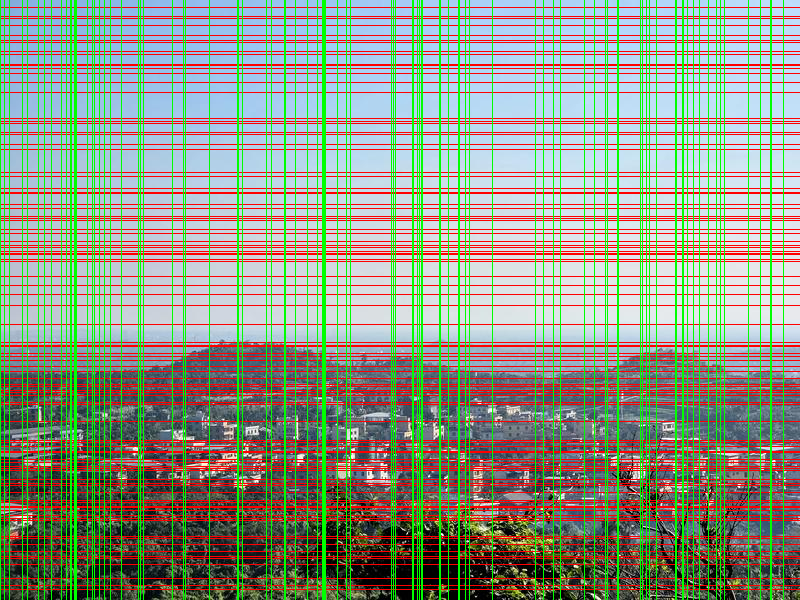

In [ ]:
# 随机选取100列
selected_cols = np.sort(np.random.randint(0, img.shape[1], 100))  # 先随机，后排序

# 同时显示 selected_rows 和 selected_cols
overlay = img.copy()
overlay[selected_rows] = (255, 0, 0)     # 花式索引
overlay[:, selected_cols] = (0, 255, 0)  # 花式索引
display_image(overlay)

selected_img.shape=(100, 100, 3)


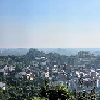

In [ ]:
# 同时索引 selected_rows 和 selected_cols
selected_img = img[np.ix_(selected_rows, selected_cols)]
print(f"{selected_img.shape=}")  # (100, 100, C)
display_image(selected_img)

## 11.5 索引与切片：view 还是 copy？

一般规则:
- 切片一般是view
- 布尔索引、花式索引是copy

更稳妥的判断方式是 `np.shares_memory`：
- True：共享底层内存（基本可以认为是 view）
- False：不共享底层内存（基本可以认为是 copy）

In [ ]:
x = np.arange(12).reshape(3, 4)
slicing = x[:, 1:3]      # 切片
indexing = x[:, [1, 2]]  # 花式索引

print(f"{np.shares_memory(x, slicing)  = }")
print(f"{np.shares_memory(x, indexing) = }")

np.shares_memory(x, slicing)  = True
np.shares_memory(x, indexing) = False


## 11.6 `np.where`：条件选择

### 11.6.1 三参数：按条件在两个值之间选（review）

In [ ]:
x = np.arange(12).reshape(3, 4)
print('x:\n', x)

x:
 [[ 0  1  2  3]
 [ 4  5  6  7]
 [ 8  9 10 11]]


In [ ]:
# 生成mask，模3=0的地方为True
mask = (x % 3 == 0)
print('\nmask:\n', mask)


mask:
 [[ True False False  True]
 [False False  True False]
 [False  True False False]]


In [ ]:
# np.where: True选x，False选-1
y = np.where(mask, x, -1)
print('y:\n', y)

y:
 [[ 0 -1 -1  3]
 [-1 -1  6 -1]
 [-1  9 -1 -1]]


### 11.6.2 一参数：返回满足条件的位置坐标（用于定位）

In [ ]:
idx = np.where(mask)
print(f"{idx=}")
print(f"{x[idx]=}")

idx=(array([0, 0, 1, 2]), array([0, 3, 2, 1]))
x[idx]=array([0, 3, 6, 9])


## 11.7 `take` / `take_along_axis`：沿某个轴按索引取值 (仅了解)

In [ ]:
# np.take()示例:
x = np.arange(24) + 1
idx = [0, 5, 6, 23]
t = np.take(x, idx)
print('take idx ->', t)

take idx -> [ 1  6  7 24]


In [ ]:
# np.take_along_axis示例:
x = np.array([[10, 30, 20],
              [13,  9, 18]])
arg = np.argmax(x, axis=1)          # 每行单独排序(axis=1)，返回每行最大值的列号: (2,)
picked = np.take_along_axis(x, arg[:, None], axis=1) # 第0行取arg[0], 第1行取arg[1]。即拿到最大值。
print('x:\n', x)
print('argmax per row:', arg)
print('picked:\n', picked)
print('picked.shape =', picked.shape)

x:
 [[10 30 20]
 [13  9 18]]
argmax per row: [1 2]
picked:
 [[30]
 [18]]
picked.shape = (2, 1)


## 11.8 小结

- **切片（slice）**：
  - 范围选择
  - 通常共享内存（view）
  - 通常速度最快
- **布尔索引（boolean）**：
  - 按条件筛选；也可用 1D mask 做按行/列选择
  - 通常不共享原数组内存（copy）
  - 通常速度适中
- **花式索引（integer array）**：
  - 显式点选/灵活索引数据
  - 通常不共享原数组内存（copy）
  - 非线性遍历内存
  - 通常速度较慢